In [1]:
import sys
sys.path.append("../")

In [2]:
import pandas as pd
import plotly.graph_objects as go
from technicals.indicators import RSI
from technicals.patterns import apply_patterns
from plotting import CandlePlot
import numpy as np

from infrastructure.quotehistory_collection import quotehistoryCollection as qc
from simulation.ema_cross_multi_temporal_2_tester import EmaCrossMultiTemporal2Tester
from simulation.ema_cross_multi_temporal_3_tester import EmaCrossMultiTemporal3Tester
from simulation.ema_cross_multi_temporal_3_tester_fast import EmaCrossMultiTemporal3TesterFast
from simulation.donchian_multi_temporal_4_tester import DonchianMultiTemporal4Tester
from simulation.donchian_multi_temporal_5_tester import DonchianMultiTemporal5Tester

In [3]:
from multiprocessing import Process, Manager
import pickle
import warnings
warnings.filterwarnings('ignore')



In [4]:


# Função para calcular a EMA
def calculate_ema(data, period):
    return data.ewm(span=period, adjust=False).mean()



In [5]:

BUY_REVERSE = 1
SELL_REVERSE = -1
BUY_TREND = 2
SELL_TREND = -2
NONE = 0

def apply_donchian_reverse(row,spread=50):
    if row.SPREAD < spread and row.DELTA_DONCHIAN_HIGH < 0 and row.DELTA_DONCHIAN_HIGH_PREV >= 0:
        return SELL_REVERSE
    elif row.SPREAD < spread and row.DELTA_DONCHIAN_LOW > 0 and row.DELTA_DONCHIAN_LOW_PREV <= 0:
        return BUY_REVERSE
    return NONE
    
def apply_donchian_trend(row,spread=50):
    if row.SPREAD < spread and row.DELTA_DONCHIAN_HIGH > 0 and row.DELTA_DONCHIAN_HIGH_PREV <= 0:
        return BUY_TREND
    elif row.SPREAD < spread and row.DELTA_DONCHIAN_LOW < 0 and row.DELTA_DONCHIAN_LOW_PREV >= 0:
        return SELL_TREND
    return NONE
    

In [6]:
def run_pair(pair,pip_value,granularity='M5',use_spread=True,
             stop_loss = 1000, take_profit = 200, 
             fixed_tp_sl=True,trans_cost=8,
             neg_multiplier=1.5, rev=True,
            spread_limit=50,ema_1 = 10,ema_2 = 480,donchian_window = 10000,windows_donchian_prev = 10):
    df = pd.read_pickle(f"../data/{granularity}/{pair}_{granularity}.pkl")
    df.reset_index(drop=True, inplace=True)

    df[f'EMA_short'] = df.mid_c.ewm(span=ema_1, min_periods=ema_1).mean()
    df[f'EMA_long'] = df.mid_c.ewm(span=ema_2, min_periods=ema_2).mean()

    df['DELTA_EMA'] = df[f'EMA_short'] - df[f'EMA_long']
    df['DELTA_EMA_PREV'] = df.DELTA_EMA.shift(1)

    ema_3 = 10000
    df[f'EMA_{ema_1}'] = df.mid_c.ewm(span=ema_1, min_periods=ema_1).mean()
    df[f'EMA_{ema_2}'] = df.mid_c.ewm(span=ema_2, min_periods=ema_2).mean()
    df[f'EMA_{ema_3}'] = df.mid_c.ewm(span=ema_3, min_periods=ema_3).mean()
    df['DIRECTION'] = df[f'EMA_{ema_2}'] - df[f'EMA_{ema_3}']
  
    df['DELTA_EMA_1'] = df[f'EMA_{ema_1}'] - df[f'EMA_{ema_2}']
    df['DELTA_EMA_1_PREV'] = df.DELTA_EMA_1.shift(1)
    
    df['DELTA_EMA_2'] = df[f'EMA_{ema_1}'] - df[f'EMA_{ema_3}']
    df['DELTA_EMA_2_PREV'] = df.DELTA_EMA_2.shift(1)

    
    df['donchian_high'] = df['mid_c'].rolling(window=donchian_window).max()
    df['donchian_low'] = df['mid_c'].rolling(window=donchian_window).min()
    df['donchian_mid'] = (df['donchian_high'] + df['donchian_low']) / 2
    df['donchian_25'] = (df['donchian_mid'] + df['donchian_low']) / 2
    df['donchian_75'] = (df['donchian_high'] + df['donchian_mid']) / 2
    
    df['donchian_high_prev'] = df.donchian_high.shift(windows_donchian_prev)
    df['donchian_low_prev'] = df.donchian_low.shift(windows_donchian_prev)
    df['donchian_mid_prev'] = df.donchian_mid.shift(windows_donchian_prev)
    
    df['DELTA_EMA_3'] = df[f'EMA_{ema_1}'] - df[f'donchian_mid']
    df['DELTA_EMA_3_PREV'] = df.DELTA_EMA_3.shift(1)

    df['DELTA_DONCHIAN_HIGH'] = df[f'EMA_{ema_1}'] - df[f'donchian_high_prev'] 
    df['DELTA_DONCHIAN_HIGH_PREV'] = df.DELTA_DONCHIAN_HIGH.shift(1)
    df['DELTA_DONCHIAN_LOW'] = df[f'EMA_{ema_1}'] - df[f'donchian_low_prev'] 
    df['DELTA_DONCHIAN_LOW_PREV'] = df.DELTA_DONCHIAN_LOW.shift(1)

    df['DELTA_EMA_MID'] = df[f'EMA_short'] - df[f'donchian_mid']
    df['DELTA_EMA_MID_PREV'] = df.DELTA_EMA_MID.shift(1)
    df['DELTA_EMA_HIGH'] = df[f'EMA_short'] - df[f'donchian_high_prev']
    df['DELTA_EMA_HIGH_PREV'] = df.DELTA_EMA_HIGH.shift(1)
    df['DELTA_EMA_LOW'] = df[f'EMA_short'] - df[f'donchian_low_prev']
    df['DELTA_EMA_LOW_PREV'] = df.DELTA_EMA_LOW.shift(1)
    
    df['SPREAD'] = (df[f'ask_c'] - df[f'bid_c']) / pip_value
    df_slim = df.copy()
    df_slim.dropna(inplace=True)
    df_slim.reset_index(drop=True, inplace=True)

    gt = DonchianMultiTemporal5Tester(
        df_slim,
        apply_donchian_reverse,
        apply_donchian_trend,
        pip_value,
        use_spread=use_spread,
        LOSS_FACTOR = stop_loss,
        PROFIT_FACTOR = take_profit,
        fixed_tp_sl=fixed_tp_sl,
        trans_cost=trans_cost,
        neg_multiplier=neg_multiplier,
        rev=rev,
        spread_limit=spread_limit
    )
    
    gt.run_test()
    return gt

In [7]:
pairs_pip_size = {
    # "EURGBP": 0.0001,
    # "EURJPY": 0.01,
    # "GBPJPY": 0.01,
    "GBPUSD": {
        "pip_value": 0.0001,  
        "spread": 15,       
        "trans_cost": 1
    },
    "USDJPY": {
        "pip_value": 0.01,  
        "spread": 10,       
        "trans_cost": 1
    },
    "EURUSD": {
        "pip_value": 0.0001,  
        "spread": 15,       
        "trans_cost": 1
    },
    "XAUUSD": { 
        "pip_value": 0.01,  
        "spread": 50,       
        "trans_cost": 10
    },
    "ETHUSD": { 
        "pip_value": 0.01,  
        "spread": 50,       
        "trans_cost": 600
    },
    "ETHEUR": { 
        "pip_value": 0.01, 
        "spread": 50,       
        "trans_cost": 600
    },
    # "ETHJPY":{ 
    #     "pip_value": 0.01,
    #     "spread": 50000,     
    #     "trans_cost": 84000
    # },
    "ETHBTC":{ 
        "pip_value": 0.0001,
        "spread": 10,   
        "trans_cost": 2
    },
    # "BTCEUR": { 
    #     "pip_value": 0.01,  
    #     "spread": 500,       
    #     "trans_cost": 28000
    # },
    # "BTCGBP": { 
    #     "pip_value": 0.01,
    #     "spread": 500,     
    #     "trans_cost": 20000
    # },
    # # "BTCJPY":{ 
    # #     "pip_value": 0.01,
    # #     "spread": 50000,     
    # #     "trans_cost": 4000000
    # # },
    # "BTCUSD":{ 
    #     "pip_value": 0.01,
    #     "spread": 500,       
    #     "trans_cost": 28000
    # },
    
    

}

pairs_pip_size = {
    "XAUUSD": { 
        "pip_value": 0.01,  
        "spread": 50,       
        "trans_cost": 10
    }
}

In [8]:

def get_list_args():
    args_dic_list = []
    for es in [5]:
        for el in [100,500,1000]:
            for dw in [2000,5000,10000]:
                for wdp in [50,250,1000]:
                    if wdp < dw and es < el and el < dw:
                        args_dic = {"es": es,"el": el,"dw": dw,"wdp": wdp}
                        args_dic_list.append(args_dic)

    return args_dic_list

def run_process(L,pairs_pip_size,pair, arg):
    tp = 50000000
    sl = 50000000
    neg_multiplier = 1
    rev = False
    print("PROCESS",arg)
    L.append(
        dict(
            pair=pair,
            stop_loss=sl,
            take_profit=tp,
            arg=arg,
            pairs_pip_size=pairs_pip_size,
            neg_multiplier=neg_multiplier,
            rev=rev,
            granularity='M1',
            res=run_pair(
                pair,
                pairs_pip_size[pair]['pip_value'],
                granularity='M1',
                use_spread=True,
                stop_loss=sl,
                take_profit=tp,
                fixed_tp_sl=True,
                trans_cost=pairs_pip_size[pair]['trans_cost'],
                neg_multiplier=neg_multiplier,
                rev=rev,
                spread_limit=pairs_pip_size[pair]['spread'],
                ema_1=arg['es'],
                ema_2=arg['el'],
                donchian_window = arg['dw'],
                windows_donchian_prev = arg['wdp']
            )
        )
    )

def run_ema_macd():
    with Manager() as manager:
        L = manager.list()  # <-- can be shared between processes.
        pair = 'XAUUSD'
        args_list = get_list_args()
        print(len(args_list))
        limit = 4
        current = 0
    
        while current < len(args_list):
            
            processes = []
            todo = len(args_list) - current
            if todo < limit:
                limit = todo
    
            for _ in range(limit):
                processes.append(Process(target=run_process, args=(L,pairs_pip_size,pair,args_list[current])))
                current += 1
    
            for p in processes:
                p.start()
    
            for p in processes:
                p.join()
    
        print("ALL DONE")
        lista = list(L)
        with open(f"./data/test-reverse-high-low.pkl", "wb") as f:
            pickle.dump(lista, f)  # Usa o pickle para salvar o arquivo


In [9]:
run_ema_macd()

27
PROCESSPROCESS  
{'es': 5, 'el': 100, 'dw': 2000, 'wdp': 50}{'es': 5, 'el': 100, 'dw': 2000, 'wdp': 250}PROCESS
 {'es': 5, 'el': 100, 'dw': 2000, 'wdp': 1000}PROCESS 
{'es': 5, 'el': 100, 'dw': 5000, 'wdp': 50}

Result: -74949.9999999999
Len loss:  77
Len Open: 1
Len Close: 834
Len Pos 580
Len Neg 254
Res pos 223121.00000000017
Res neg 298071.0000000001
Rel len pos neg 0.6954436450839329
Rel len neg pos 0.30455635491606714
Rel pos neg 0.42809751492732057
Rel neg pos 0.5719024850726795


Result: 21717.999999999567
Len loss:  54
Len Open: 1
Len Close: 500
Len Pos 433
Len Neg 67
Res pos 238321.9999999997
Res neg 216604.00000000015
Rel len pos neg 0.866
Rel len neg pos 0.134
Rel pos neg 0.5238698161898854
Rel neg pos 0.4761301838101146


Result: -28637.000000000397
Len loss:  119
Len Open: 1
Len Close: 818
Len Pos 637
Len Neg 181
Res pos 327174.99999999977
Res neg 355812.0000000001
Rel len pos neg 0.7787286063569682
Rel len neg pos 0.22127139364303178

Rel pos negResult: 0.4790354721246

In [14]:
file_path = './data/test-reverse-high-low.pkl'
# file_path = './data/test-trend-mid.pkl'
with open(file_path, "rb") as f:
    data = pickle.load(f)

In [15]:
# data

In [16]:
df = data[0]['res'].df
df.columns

Index(['time', 'bid_o', 'bid_h', 'bid_l', 'bid_c', 'ask_o', 'ask_h', 'ask_l',
       'ask_c', 'mid_o', 'mid_h', 'mid_l', 'mid_c', 'EMA_short', 'EMA_long',
       'DELTA_EMA', 'DELTA_EMA_PREV', 'EMA_5', 'EMA_100', 'EMA_10000',
       'DIRECTION', 'DELTA_EMA_1', 'DELTA_EMA_1_PREV', 'DELTA_EMA_2',
       'DELTA_EMA_2_PREV', 'donchian_high', 'donchian_low', 'donchian_mid',
       'donchian_25', 'donchian_75', 'donchian_high_prev', 'donchian_low_prev',
       'donchian_mid_prev', 'DELTA_EMA_3', 'DELTA_EMA_3_PREV',
       'DELTA_DONCHIAN_HIGH', 'DELTA_DONCHIAN_HIGH_PREV', 'DELTA_DONCHIAN_LOW',
       'DELTA_DONCHIAN_LOW_PREV', 'DELTA_EMA_MID', 'DELTA_EMA_MID_PREV',
       'DELTA_EMA_HIGH', 'DELTA_EMA_HIGH_PREV', 'DELTA_EMA_LOW',
       'DELTA_EMA_LOW_PREV', 'SPREAD', 'SIGNAL', 'SIGNAL_TREND',
       'FINAL_SIGNAL'],
      dtype='object')

In [17]:
for r in data:
    print(r['pair'], r['res'].df_results.result.sum())

XAUUSD -74949.9999999999
XAUUSD 21717.999999999567
XAUUSD -46871.00000000013
XAUUSD -28637.000000000397
XAUUSD 9821.999999999738
XAUUSD 10264.000000000153
XAUUSD 19113.999999999898
XAUUSD -18393.00000000013
XAUUSD 24856.999999999876
XAUUSD -27641.99999999972
XAUUSD -53671.00000000038
XAUUSD -27071.999999999654
XAUUSD 33893.99999999977
XAUUSD 11776.000000000022
XAUUSD 7623.000000000206
XAUUSD 13250.000000000095
XAUUSD 4105.000000000182
XAUUSD 22956.999999999935
XAUUSD -10621.000000000175
XAUUSD -15018.000000000251
XAUUSD 39869.999999999345
XAUUSD -21671.000000000477
XAUUSD 24043.999999999753
XAUUSD 25561.999999999716
XAUUSD 22846.99999999929
XAUUSD 25829.9999999998
XAUUSD 27121.999999999764


In [18]:

res_rel = []
for r in data:
    df_results = r['res'].df_results
    res_pos = df_results[df_results['result'] > 0]
    res_neg = df_results[df_results['result'] < 0]
    sum_neg = res_neg.result.sum() * -1
    sum_pos = res_pos.result.sum()
    res_rel.append(
        dict(
            res_sum = df_results.result.sum(),
            sum_neg = sum_neg,
            sum_pos = sum_pos,
            arg=r['arg'],
            len_acc_loss = len(r['res'].acumulated_loss),
            # len_open_trades = len(open_trades_m5)
            # len_close_trades = len(closed_trades_m5)
            len_res_pos = len(res_pos),
            len_res_neg = len(res_neg),
            rel_len_pos_neg = len(res_pos)/(len(res_pos)+ len(res_neg)),
            rel_len_neg_pos = len(res_neg)/(len(res_pos)+ len(res_neg)),
            rel_pos_neg = sum_pos/(sum_pos+ sum_neg),
            rel_neg_pos = sum_neg/(sum_pos+ sum_neg),
            mean_neg = sum_neg/len(res_neg),
            mean_pos = sum_pos/len(res_pos)
        )
    )


In [19]:
df_res = pd.DataFrame(res_rel)

In [20]:
df_res.head()

,res_sum,sum_neg,sum_pos,arg,len_acc_loss,len_res_pos,len_res_neg,rel_len_pos_neg,rel_len_neg_pos,rel_pos_neg,rel_neg_pos,mean_neg,mean_pos
0,-74950.0,298071.0,223121.0,"{'es': 5, 'el': 100, 'dw': 2000, 'wdp': 1000}",77,580,254,0.695444,0.304556,0.428098,0.571902,1173.507874,384.691379
1,21718.0,216604.0,238322.0,"{'es': 5, 'el': 100, 'dw': 5000, 'wdp': 50}",54,433,67,0.866000,0.134000,0.523870,0.476130,3232.895522,550.397229
2,-46871.0,349263.0,302392.0,"{'es': 5, 'el': 100, 'dw': 2000, 'wdp': 250}",108,721,235,0.754184,0.245816,0.464037,0.535963,1486.225532,419.406380
3,-28637.0,355812.0,327175.0,"{'es': 5, 'el': 100, 'dw': 2000, 'wdp': 50}",119,637,181,0.778729,0.221271,0.479035,0.520965,1965.812155,513.618524
4,9822.0,184143.0,193965.0,"{'es': 5, 'el': 100, 'dw': 5000, 'wdp': 1000}",34,391,112,0.777336,0.222664,0.512988,0.487012,1644.133929,496.074169


In [21]:
df_res.describe()

,res_sum,sum_neg,sum_pos,len_acc_loss,len_res_pos,len_res_neg,rel_len_pos_neg,rel_len_neg_pos,rel_pos_neg,rel_neg_pos,mean_neg,mean_pos
count,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000
mean,744.777778,206590.518519,207335.296296,47.518519,321.592593,102.111111,0.768587,0.231413,0.507120,0.492880,2608.076542,744.777675
std,29489.881938,63595.742347,40597.906649,25.412550,153.377177,66.676217,0.078644,0.078644,0.033742,0.033742,1131.650713,258.085649
min,-74950.000000,136050.000000,162494.000000,22.000000,127.000000,32.000000,0.588083,0.095628,0.428098,0.441597,1173.507874,384.691379
25%,-20032.000000,157897.000000,183435.500000,31.500000,216.500000,56.000000,0.713631,0.182652,0.479852,0.463504,1654.480138,532.007876
50%,10264.000000,185387.000000,198637.000000,34.000000,308.000000,67.000000,0.795511,0.204489,0.513439,0.486561,2283.818182,691.142276
75%,23500.500000,240164.500000,220683.500000,56.000000,387.000000,160.500000,0.817348,0.286369,0.536496,0.520148,3117.690580,926.300319
max,39870.000000,355812.000000,327175.000000,119.000000,721.000000,254.000000,0.904372,0.411917,0.558403,0.571902,4953.828571,1284.818898


In [22]:
df_res[df_res['rel_len_pos_neg']>0.9]

,res_sum,sum_neg,sum_pos,arg,len_acc_loss,len_res_pos,len_res_neg,rel_len_pos_neg,rel_len_neg_pos,rel_pos_neg,rel_neg_pos,mean_neg,mean_pos
6,19114.0,173384.0,192498.0,"{'es': 5, 'el': 100, 'dw': 10000, 'wdp': 50}",34,331,35,0.904372,0.095628,0.52612,0.47388,4953.828571,581.564955


In [23]:
df_results = data[6]['res'].df_results
df = data[6]['res'].df
print(df_results.columns)
res_pos = df_results[df_results['result'] > 0]
res_neg = df_results[df_results['result'] < 0]
df_results.shape, res_pos.shape, res_neg.shape

Index(['running', 'start_index_m5', 'profit_factor', 'loss_factor',
       'pip_value', 'count', 'neg_multiplier', 'trans_cost', 'trigger_type',
       'start_price', 'trigger_price', 'SIGNAL', 'FINAL_SIGNAL', 'result',
       'end_time', 'start_time'],
      dtype='object')


((366, 16), (331, 16), (35, 16))

In [24]:
df_results.describe()

,start_index_m5,profit_factor,loss_factor,pip_value,count,neg_multiplier,trans_cost,trigger_type,start_price,trigger_price,SIGNAL,FINAL_SIGNAL,result,end_time,start_time
count,366.000000,366.0,366.0,3.660000e+02,366.000000,366.0,366.0,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366,366
mean,309269.368852,50000000.0,50000000.0,1.000000e-02,1572.357923,1.0,10.0,1.601093,2101.216749,2102.402951,-0.008197,-0.191257,52.224044,2023-11-28 20:14:05.081967104,2023-11-27 05:11:35.245901568
min,474.000000,50000000.0,50000000.0,1.000000e-02,3.000000,1.0,10.0,1.000000,1809.460000,1807.080000,-1.000000,-1.000000,-10284.000000,2023-01-12 13:34:00,2023-01-12 13:31:00
25%,177528.750000,50000000.0,50000000.0,1.000000e-02,88.250000,1.0,10.0,1.000000,1921.302500,1921.825000,0.000000,-1.000000,260.750000,2023-07-15 04:13:45,2023-07-13 12:17:45
50%,291298.500000,50000000.0,50000000.0,1.000000e-02,379.500000,1.0,10.0,1.000000,1991.565000,1992.150000,0.000000,-1.000000,443.000000,2023-11-08 16:59:00,2023-11-08 03:05:30
75%,468185.250000,50000000.0,50000000.0,1.000000e-02,1610.250000,1.0,10.0,2.000000,2329.952500,2325.910000,0.000000,1.000000,680.750000,2024-05-10 03:56:30,2024-05-10 01:16:15
max,602531.000000,50000000.0,50000000.0,1.000000e-02,16109.000000,1.0,10.0,6.000000,2662.350000,2672.850000,1.000000,1.000000,3121.000000,2024-09-26 10:20:00,2024-09-25 03:19:00
std,175978.140678,0.0,0.0,1.737098e-18,2699.335472,0.0,0.0,0.817211,236.146908,237.495099,0.138241,0.982884,1790.849767,NaN,NaN


In [49]:
df['high_low'] = (df['donchian_high'] - df['donchian_low']) / 0.01

df.describe()

,time,bid_o,bid_h,bid_l,bid_c,ask_o,ask_h,ask_l,ask_c,mid_o,...,DELTA_EMA_MID_PREV,DELTA_EMA_HIGH,DELTA_EMA_HIGH_PREV,DELTA_EMA_LOW,DELTA_EMA_LOW_PREV,SPREAD,SIGNAL,SIGNAL_TREND,FINAL_SIGNAL,high_low
count,606350,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,...,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000,606350.000000
mean,2023-11-21 05:12:58.094763776,2098.039867,2098.316743,2097.763063,2098.040124,2098.249866,2098.526613,2097.973093,2098.251746,2098.144866,...,4.334383,-33.227581,-33.227540,42.021901,42.021818,21.162189,-0.000277,0.000557,0.000097,7525.576625
min,2023-01-12 05:36:00,1806.640000,1806.910000,1804.680000,1806.700000,1806.800000,1807.110000,1804.780000,1806.820000,1806.720000,...,-77.834570,-158.323699,-158.323699,-25.718108,-25.718108,-361.000000,-1.000000,-2.000000,-2.000000,2489.000000
25%,2023-06-16 12:14:15,1936.990000,1937.170000,1936.820000,1936.990000,1937.210000,1937.390000,1937.050000,1937.210000,1937.100000,...,-15.168940,-45.248145,-45.248145,15.228060,15.228060,16.000000,0.000000,0.000000,0.000000,5018.000000
50%,2023-11-20 17:48:30,2013.470000,2013.740000,2013.200000,2013.470000,2013.700000,2013.975000,2013.450000,2013.690000,2013.592500,...,3.326373,-26.624795,-26.624651,32.278329,32.278329,21.000000,0.000000,0.000000,0.000000,6707.500000
75%,2024-04-26 07:30:45,2320.090000,2320.440000,2319.760000,2320.090000,2320.290000,2320.640000,2319.960000,2320.290000,2320.190000,...,23.064563,-11.534185,-11.534069,60.181060,60.181060,25.000000,0.000000,0.000000,0.000000,9857.500000
max,2024-09-27 20:57:00,2685.510000,2685.560000,2684.470000,2685.550000,2685.690000,2685.750000,2684.580000,2685.730000,2685.600000,...,96.554747,54.768362,54.768362,195.297247,195.297247,437.000000,1.000000,2.000000,2.000000,19677.500000
std,NaN,214.282713,214.340680,214.224412,214.284134,214.271114,214.328533,214.212614,214.272096,214.276909,...,27.012208,28.197966,28.197994,34.623277,34.623173,8.992640,0.034697,0.069441,0.054530,3188.958458


In [41]:
df_results['SIGNAL'].value_counts()

SIGNAL
0    358
Name: count, dtype: int64

In [42]:
df_results['FINAL_SIGNAL'].value_counts()

FINAL_SIGNAL
 2    211
-2    147
Name: count, dtype: int64

In [43]:
df_results.result.sum()

np.float64(55420.99999999999)

In [44]:
sum_neg = res_neg.result.sum()
sum_neg, sum_neg/res_neg.shape[0]

(np.float64(-156534.9999999999), np.float64(-3478.555555555554))

In [45]:
sum_pos = res_pos.result.sum()
sum_pos, sum_pos/res_pos.shape[0]

(np.float64(211955.99999999994), np.float64(677.1757188498401))

In [46]:
res_neg.describe()

,start_index_m5,profit_factor,loss_factor,pip_value,count,neg_multiplier,trans_cost,trigger_type,start_price,trigger_price,SIGNAL,FINAL_SIGNAL,result,end_time,start_time
count,45.000000,45.0,45.0,4.500000e+01,45.000000,45.0,45.0,45.000000,45.000000,45.000000,45.0,45.000000,45.000000,45,45
mean,325801.977778,50000000.0,50000000.0,1.000000e-02,4821.800000,1.0,10.0,2.911111,2110.936222,2110.379556,0.0,-0.133333,-3478.555556,2023-12-19 10:48:00,2023-12-14 09:39:50.666666752
min,13129.000000,50000000.0,50000000.0,1.000000e-02,16.000000,1.0,10.0,1.000000,1807.080000,1845.990000,0.0,-2.000000,-10579.000000,2023-01-31 08:10:00,2023-01-25 19:58:00
25%,210989.000000,50000000.0,50000000.0,1.000000e-02,79.000000,1.0,10.0,2.000000,1937.140000,1931.010000,0.0,-2.000000,-5216.000000,2023-08-16 18:40:00,2023-08-16 18:04:00
50%,323015.000000,50000000.0,50000000.0,1.000000e-02,4812.000000,1.0,10.0,3.000000,1992.390000,2009.160000,0.0,-2.000000,-3675.000000,2023-12-11 10:29:00,2023-12-11 09:43:00
75%,495557.000000,50000000.0,50000000.0,1.000000e-02,8336.000000,1.0,10.0,4.000000,2350.200000,2337.320000,0.0,2.000000,-227.000000,2024-06-07 13:48:00,2024-06-07 03:41:00
max,591343.000000,50000000.0,50000000.0,1.000000e-02,16190.000000,1.0,10.0,4.000000,2562.330000,2561.570000,0.0,2.000000,-1.000000,2024-09-13 00:59:00,2024-09-13 00:43:00
std,172013.612827,0.0,0.0,1.754325e-18,4210.755528,0.0,0.0,1.083392,228.898158,223.660583,0.0,2.018100,2783.089499,NaN,NaN


In [47]:
res_pos.describe()


,start_index_m5,profit_factor,loss_factor,pip_value,count,neg_multiplier,trans_cost,trigger_type,start_price,trigger_price,SIGNAL,FINAL_SIGNAL,result,end_time,start_time
count,313.000000,313.0,313.0,313.00,313.000000,313.0,313.0,313.000000,313.000000,313.000000,313.0,313.000000,313.000000,313,313
mean,305856.501597,50000000.0,50000000.0,0.01,1066.702875,1.0,10.0,1.610224,2096.895687,2100.063419,0.0,0.428115,677.175719,2023-11-24 18:15:20.511182080,2023-11-23 16:06:06.709265152
min,405.000000,50000000.0,50000000.0,0.01,1.000000,1.0,10.0,1.000000,1807.370000,1807.080000,0.0,-2.000000,3.000000,2023-01-12 13:34:00,2023-01-12 12:21:00
25%,176431.000000,50000000.0,50000000.0,0.01,180.000000,1.0,10.0,1.000000,1919.080000,1921.730000,0.0,-2.000000,184.000000,2023-07-13 02:17:00,2023-07-12 16:32:00
50%,275377.000000,50000000.0,50000000.0,0.01,371.000000,1.0,10.0,1.000000,1988.580000,1988.580000,0.0,2.000000,459.000000,2023-10-27 18:02:00,2023-10-20 13:57:00
75%,458207.000000,50000000.0,50000000.0,0.01,1171.000000,1.0,10.0,2.000000,2323.050000,2321.090000,0.0,2.000000,909.000000,2024-04-30 20:32:00,2024-04-30 18:57:00
max,602503.000000,50000000.0,50000000.0,0.01,15657.000000,1.0,10.0,6.000000,2666.370000,2672.850000,0.0,2.000000,3419.000000,2024-09-26 10:20:00,2024-09-25 02:51:00
std,176722.304131,0.0,0.0,0.00,1806.644800,0.0,0.0,1.022891,237.651731,240.224844,0.0,1.956770,689.844574,NaN,NaN


In [43]:
df_results.columns, df_results.shape[0]

(Index(['running', 'start_index_m5', 'profit_factor', 'loss_factor',
        'pip_value', 'count', 'neg_multiplier', 'trans_cost', 'trigger_type',
        'start_price', 'trigger_price', 'SIGNAL', 'FINAL_SIGNAL', 'result',
        'end_time', 'start_time'],
       dtype='object'),
 267)

In [44]:
df_results

,running,start_index_m5,profit_factor,loss_factor,pip_value,count,neg_multiplier,trans_cost,trigger_type,start_price,trigger_price,SIGNAL,FINAL_SIGNAL,result,end_time,start_time
0,False,581,50000000,50000000,0.01,360,1,10,1,1901.72,1901.85,0,2,3.0,2023-01-13 14:09:00,2023-01-13 08:09:00
1,False,941,50000000,50000000,0.01,1152,1,10,1,1901.85,1916.88,0,2,1493.0,2023-01-16 10:22:00,2023-01-13 14:09:00
2,False,2093,50000000,50000000,0.01,2324,1,10,3,1916.88,1897.07,0,2,-1991.0,2023-01-18 05:36:00,2023-01-16 10:22:00
3,False,6633,50000000,50000000,0.01,578,1,10,1,1929.79,1929.02,0,2,-87.0,2023-01-20 06:10:00,2023-01-19 19:32:00
4,False,7211,50000000,50000000,0.01,72,1,10,5,1929.02,1929.90,0,2,77.0,2023-01-20 07:22:00,2023-01-20 06:10:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,False,600791,50000000,50000000,0.01,768,1,10,5,2635.26,2668.11,0,2,3242.0,2024-09-25 02:57:00,2024-09-24 13:09:00
263,False,602165,50000000,50000000,0.01,1217,1,10,1,2661.95,2672.85,0,2,1080.0,2024-09-26 10:20:00,2024-09-25 13:03:00
264,False,603382,50000000,50000000,0.01,411,1,10,1,2672.85,2671.38,0,2,-157.0,2024-09-26 17:11:00,2024-09-26 10:20:00
265,False,603793,50000000,50000000,0.01,61,1,10,5,2671.38,2673.19,0,2,147.0,2024-09-26 18:12:00,2024-09-26 17:11:00


In [47]:
df.columns

Index(['time', 'bid_o', 'bid_h', 'bid_l', 'bid_c', 'ask_o', 'ask_h', 'ask_l',
       'ask_c', 'mid_o', 'mid_h', 'mid_l', 'mid_c', 'EMA_short', 'EMA_long',
       'DELTA_EMA', 'DELTA_EMA_PREV', 'EMA_5', 'EMA_480', 'EMA_10000',
       'DIRECTION', 'DELTA_EMA_1', 'DELTA_EMA_1_PREV', 'DELTA_EMA_2',
       'DELTA_EMA_2_PREV', 'donchian_high', 'donchian_low', 'donchian_mid',
       'donchian_high_prev', 'donchian_low_prev', 'donchian_mid_prev',
       'DELTA_EMA_3', 'DELTA_EMA_3_PREV', 'DELTA_DONCHIAN_HIGH',
       'DELTA_DONCHIAN_HIGH_PREV', 'DELTA_DONCHIAN_LOW',
       'DELTA_DONCHIAN_LOW_PREV', 'DELTA_EMA_MID', 'DELTA_EMA_MID_PREV',
       'DELTA_EMA_HIGH', 'DELTA_EMA_HIGH_PREV', 'DELTA_EMA_LOW',
       'DELTA_EMA_LOW_PREV', 'SPREAD', 'SIGNAL', 'SIGNAL_TREND',
       'FINAL_SIGNAL'],
      dtype='object')

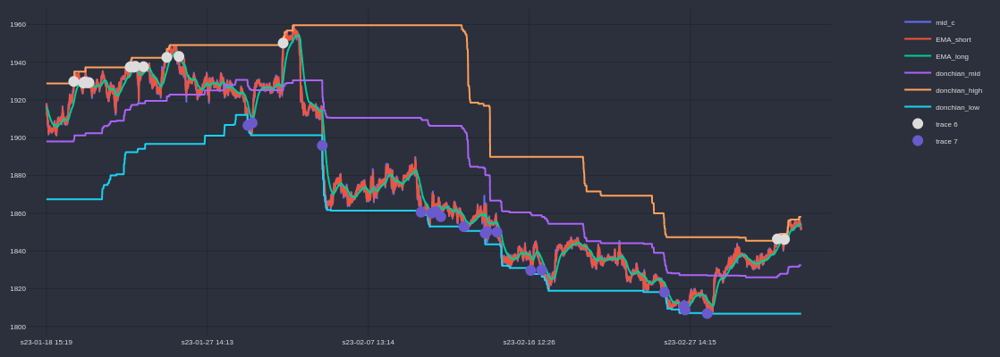

In [49]:

cp = CandlePlot(df.iloc[5000:50000],candles=False)

trades_buy = cp.df_plot[cp.df_plot.SIGNAL == BUY_REVERSE]
trades_sell = cp.df_plot[cp.df_plot.SIGNAL == SELL_REVERSE]

trades_buy_trend = cp.df_plot[cp.df_plot.SIGNAL_TREND == BUY_TREND]
trades_sell_trend = cp.df_plot[cp.df_plot.SIGNAL_TREND == SELL_TREND]

final_trades_buy = cp.df_plot[cp.df_plot.FINAL_SIGNAL == BUY_REVERSE]
final_trades_sell = cp.df_plot[cp.df_plot.FINAL_SIGNAL == SELL_REVERSE]
final_trades_buy_trend = cp.df_plot[cp.df_plot.FINAL_SIGNAL == BUY_TREND]
final_trades_sell_trend = cp.df_plot[cp.df_plot.FINAL_SIGNAL == SELL_TREND]

# trades

markers = 'mid_c'
marker_buy = '#00FF00'
marker_sell = '#FF0000'

marker_buy_trend = '#00FF00'
marker_sell_trend = '#FF0000'

marker_final_buy = '#0000FF'
marker_final_sell = '#ffa500'
marker_final_buy_trend = '#dcdcdc'
marker_final_sell_trend = '#6a5acd'

cp.add_traces(['mid_c',"EMA_short",'EMA_long','donchian_mid','donchian_high','donchian_low'])

# cp.fig.add_trace(go.Scatter(
#     x = trades_buy.sTime,
#     y = trades_buy[markers],
#     mode = 'markers',
#     marker=dict(color=marker_buy, size=12)
# ))
# cp.fig.add_trace(go.Scatter(
#     x = trades_sell.sTime,
#     y = trades_sell[markers],
#     mode = 'markers',
#     marker=dict(color=marker_sell, size=12)
# ))

# cp.fig.add_trace(go.Scatter(
#     x = trades_buy_trend.sTime,
#     y = trades_buy_trend[markers],
#     mode = 'markers',
#     marker=dict(color=marker_buy_trend, size=12)
# ))
# cp.fig.add_trace(go.Scatter(
#     x = trades_sell_trend.sTime,
#     y = trades_sell_trend[markers],
#     mode = 'markers',
#     marker=dict(color=marker_sell_trend, size=12)
# ))

# FINAL REVERSE
# cp.fig.add_trace(go.Scatter(
#     x = final_trades_buy.sTime,
#     y = final_trades_buy[markers],
#     mode = 'markers',
#     marker=dict(color=marker_final_buy, size=12)
# ))
# cp.fig.add_trace(go.Scatter(
#     x = final_trades_sell.sTime,
#     y = final_trades_sell[markers],
#     mode = 'markers',
#     marker=dict(color=marker_final_sell, size=12)
# ))

# FINAL TREND
cp.fig.add_trace(go.Scatter(
    x = final_trades_buy_trend.sTime,
    y = final_trades_buy_trend[markers],
    mode = 'markers',
    marker=dict(color=marker_final_buy_trend, size=12)
))
cp.fig.add_trace(go.Scatter(
    x = final_trades_sell_trend.sTime,
    y = final_trades_sell_trend[markers],
    mode = 'markers',
    marker=dict(color=marker_final_sell_trend, size=12)
))

cp.show_plot()

In [31]:
# cp = CandlePlot(df.iloc[0:10000])
# cp.show_plot(line_traces=['EMA_10','donchian_mid','donchian_high','donchian_low'])

In [32]:
# cp = CandlePlot(df.iloc[10000:20000])
# cp.show_plot(line_traces=['EMA_3','EMA_480','env_high1','env_low1','env_high2','env_low2'])

In [33]:
# ema_1 = 10
# ema_2 = 30
# df_4h = pd.read_pickle(f"../data/H4/{pair}_H4.pkl")
# df_4h[f'EMA_{ema_1}'] = df_4h.mid_c.ewm(span=ema_1, min_periods=ema_1).mean()
# df_4h[f'EMA_{ema_2}'] = df_4h.mid_c.ewm(span=ema_2, min_periods=ema_2).mean()

In [34]:
# cp = CandlePlot(df_4h.iloc[400:700])
# cp.show_plot(line_traces=['EMA_10','EMA_30'])

In [35]:
df_results['time'] = df_results['end_time']

In [36]:
df_results['GAIN_C'] = df_results.result.cumsum()

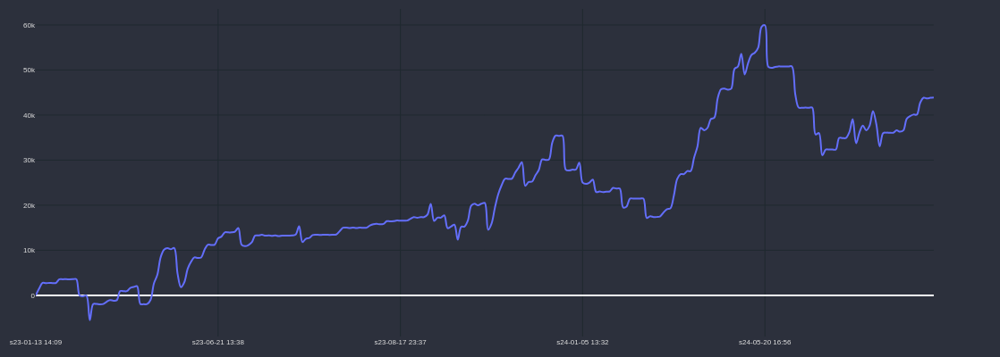

In [37]:
cp = CandlePlot(df_results, candles=False)
cp.show_plot(line_traces = ['GAIN_C'])

In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def gerar_relatorios(df):
    # Configurações gerais para gráficos
    sns.set(style="whitegrid")
    plt.figure(figsize=(10, 6))

    # 1. Análise de Desempenho por Tipo de Fechamento (Trigger Type)
    print("Relatório de Desempenho por Tipo de Fechamento")
    trigger_counts = df['trigger_type'].value_counts()
    print(trigger_counts)
    
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x='trigger_type')
    plt.title("Frequência de Operações por Trigger Type")
    plt.show()

    # 2. Análise de Rentabilidade por Compra e Venda (Signal)
    print("\nRelatório de Rentabilidade por Compra e Venda (Signal)")
    signal_profit = df.groupby('SIGNAL')['result'].mean()
    print(signal_profit)
    
    plt.figure(figsize=(10, 6))
    sns.barplot(x=signal_profit.index, y=signal_profit.values)
    plt.title("Rentabilidade Média por Compra e Venda")
    plt.show()

    # 3. Análise de Resultados por Período (start_time, end_time)
    print("\nAnálise de Resultados por Período")
    df['start_time'] = pd.to_datetime(df['start_time'])
    df['end_time'] = pd.to_datetime(df['end_time'])
    df['duration'] = (df['end_time'] - df['start_time']).dt.total_seconds() / 60
    result_over_time = df.groupby(df['start_time'].dt.date)['result'].sum()
    print(result_over_time)
    
    plt.figure(figsize=(10, 6))
    result_over_time.plot()
    plt.title("Resultados ao Longo do Tempo")
    plt.show()

    # 4. Eficiência Operacional: Diferença entre Preço de Entrada e Saída
    print("\nDiferença entre Preço de Entrada e Saída (Eficiência Operacional)")
    df['price_difference'] = df['trigger_price'] - df['start_price']
    price_diff_mean = df['price_difference'].mean()
    print(f"Média da diferença de preço: {price_diff_mean} pips")
    
    plt.figure(figsize=(10, 6))
    sns.histplot(df['price_difference'], bins=30, kde=True)
    plt.title("Distribuição da Diferença de Preço (Start vs Trigger)")
    plt.show()

    # 5. Volatilidade e Duração das Operações (Contagem de Candles)
    print("\nAnálise de Volatilidade e Duração das Operações (Contagem de Candles)")
    count_result_corr = df[['count', 'result']].corr()
    print(f"Correlação entre duração (candles) e resultado: {count_result_corr.iloc[0, 1]}")
    
    plt.figure(figsize=(10, 6))
    sns.scatterplot(data=df, x='count', y='result', hue='trigger_type', palette='viridis')
    plt.title("Relação entre Duração da Operação e Resultado")
    plt.show()

    # 6. Análise de Perdas Acumuladas (Trigger Type 3)
    print("\nAnálise de Perdas Acumuladas (Trigger Type 3)")
    acum_loss_df = df[df['trigger_type'] == 3]
    if not acum_loss_df.empty:
        acum_loss_mean = acum_loss_df['result'].mean()
        print(f"Média de pips recuperados em perdas acumuladas: {acum_loss_mean}")
        plt.figure(figsize=(10, 6))
        sns.histplot(acum_loss_df['result'], bins=30, kde=True)
        plt.title("Distribuição de Recuperação de Perdas Acumuladas (2x Perda)")
        plt.show()
    else:
        print("Nenhuma operação encerrada por Perda Acumulada")

    # 7. Eficiência do Cruzamento Reverso (Trigger Type 4)
    print("\nEficiência do Cruzamento Reverso (Trigger Type 4)")
    reversed_cross_df = df[df['trigger_type'] == 4]
    if not reversed_cross_df.empty:
        rev_cross_mean = reversed_cross_df['result'].mean()
        print(f"Resultado médio de cruzamento reverso: {rev_cross_mean}")
        plt.figure(figsize=(10, 6))
        sns.histplot(reversed_cross_df['result'], bins=30, kde=True)
        plt.title("Distribuição de Resultados - Cruzamento Reverso")
        plt.show()
    else:
        print("Nenhuma operação encerrada por Cruzamento Reverso")

    # 8. Análise de Take Profit (Trigger Type 1) e Stop Loss (Trigger Type 2)
    print("\nAnálise de Take Profit (Trigger Type 1) e Stop Loss (Trigger Type 2)")
    tp_df = df[df['trigger_type'] == 1]
    sl_df = df[df['trigger_type'] == 2]
    
    print(f"Take Profit médio: {tp_df['result'].mean()}")
    print(f"Stop Loss médio: {sl_df['result'].mean()}")
    
    plt.figure(figsize=(10, 6))
    sns.histplot(tp_df['result'], bins=30, kde=True, color='green', label='Take Profit')
    sns.histplot(sl_df['result'], bins=30, kde=True, color='red', label='Stop Loss')
    plt.legend()
    plt.title("Distribuição de Resultados - Take Profit vs Stop Loss")
    plt.show()

    # 9. Análise de Drawdown e Recuperação
    print("\nAnálise de Drawdown e Recuperação")
    df['accumulated_pips'] = df['result'].cumsum()
    plt.figure(figsize=(10, 6))
    plt.plot(df['start_time'], df['accumulated_pips'])
    plt.title("Acumulação de Pips ao Longo do Tempo (Drawdown e Recuperação)")
    plt.show()

    # 10. Eficiência Temporal e Tendências
    print("\nAnálise de Eficiência Temporal e Tendências")
    df['hour'] = df['start_time'].dt.hour
    hourly_result = df.groupby('hour')['result'].mean()
    plt.figure(figsize=(10, 6))
    sns.lineplot(x=hourly_result.index, y=hourly_result.values)
    plt.title("Rentabilidade Média por Horário")
    plt.show()

# Exemplo de uso:
# df = pd.read_csv('seu_arquivo.csv')  # Supondo que você já tem o dataframe pronto
# gerar_relatorios(df)


Relatório de Desempenho por Tipo de Fechamento
trigger_type
1    112
2     87
5     28
4     27
3     24
6     13
Name: count, dtype: int64


<Figure size 1000x600 with 0 Axes>

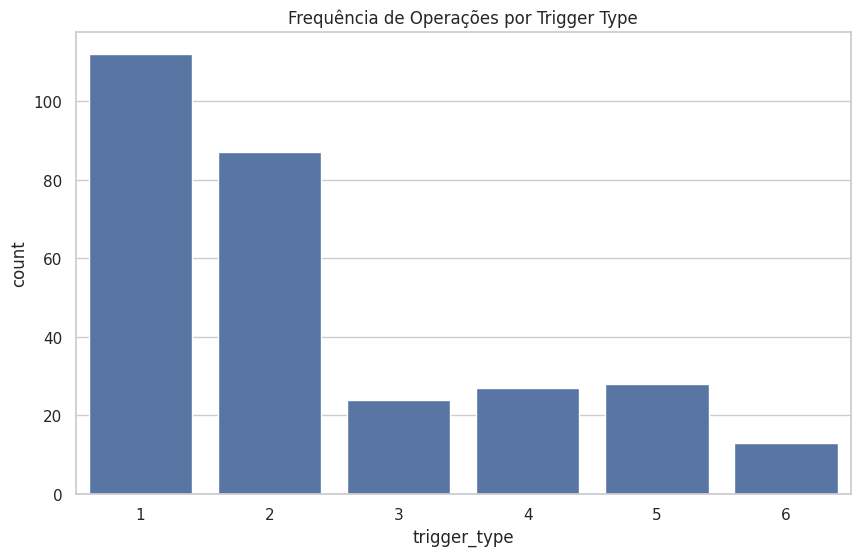


Relatório de Rentabilidade por Compra e Venda (Signal)
SIGNAL
0    252.278351
Name: result, dtype: float64


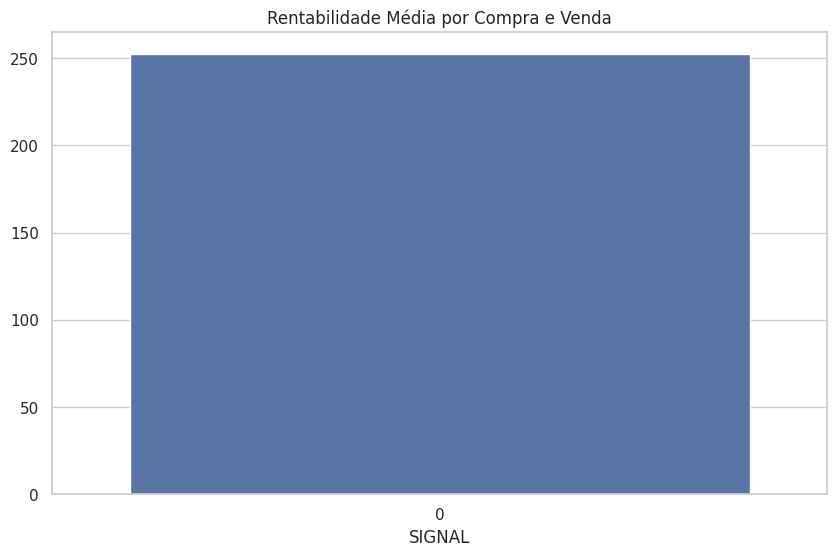


Análise de Resultados por Período
start_time
2023-01-12    1366.0
2023-01-13    2787.0
2023-01-19     626.0
2023-01-20     117.0
2023-01-24     503.0
               ...  
2024-09-16     578.0
2024-09-18   -7544.0
2024-09-20    2589.0
2024-09-23     992.0
2024-09-24    3667.0
Name: result, Length: 226, dtype: float64


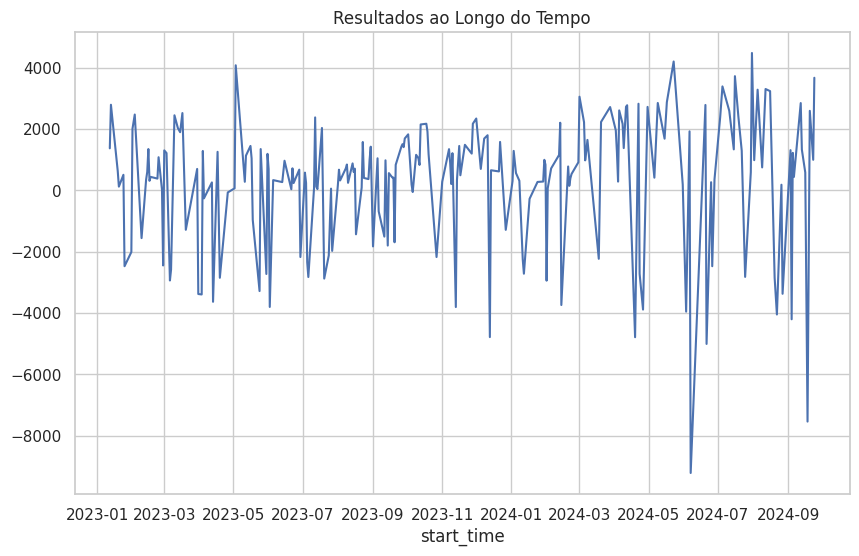


Diferença entre Preço de Entrada e Saída (Eficiência Operacional)
Média da diferença de preço: 2.9978350515463874 pips


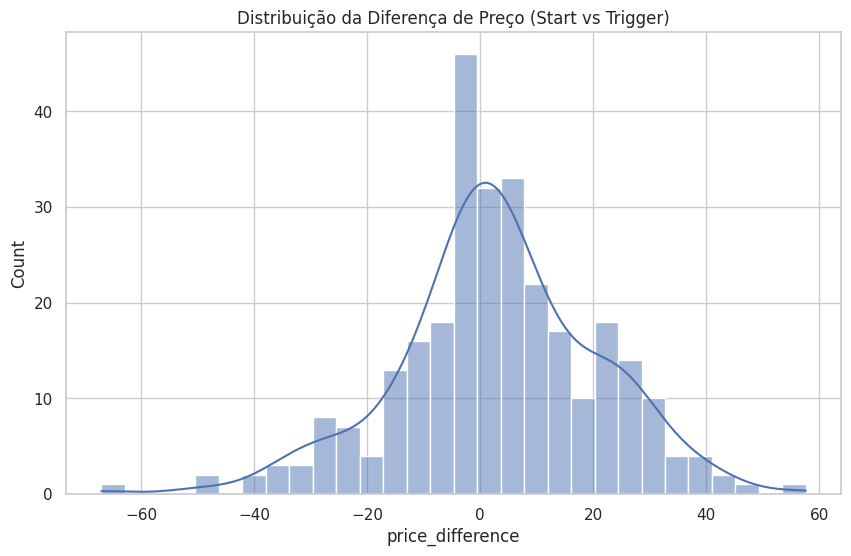


Análise de Volatilidade e Duração das Operações (Contagem de Candles)
Correlação entre duração (candles) e resultado: -0.24125605782790183


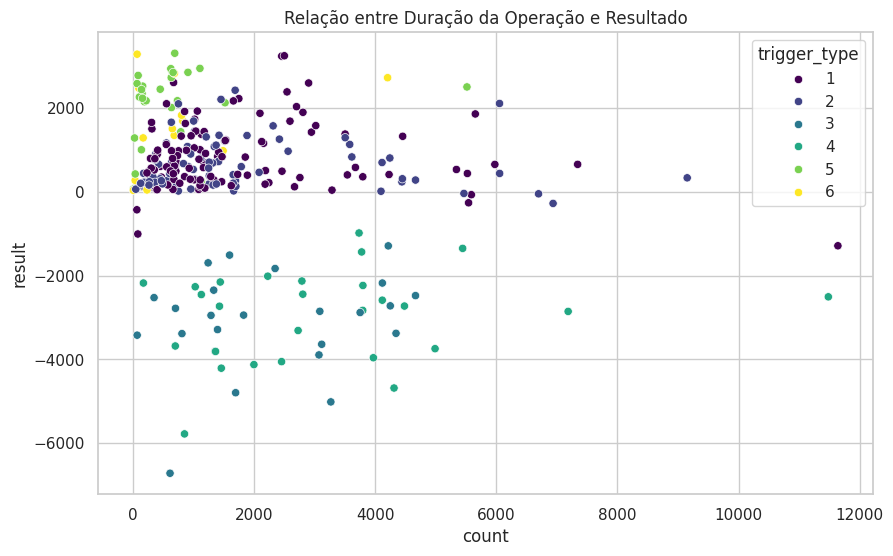


Análise de Perdas Acumuladas (Trigger Type 3)
Média de pips recuperados em perdas acumuladas: -3096.458333333337


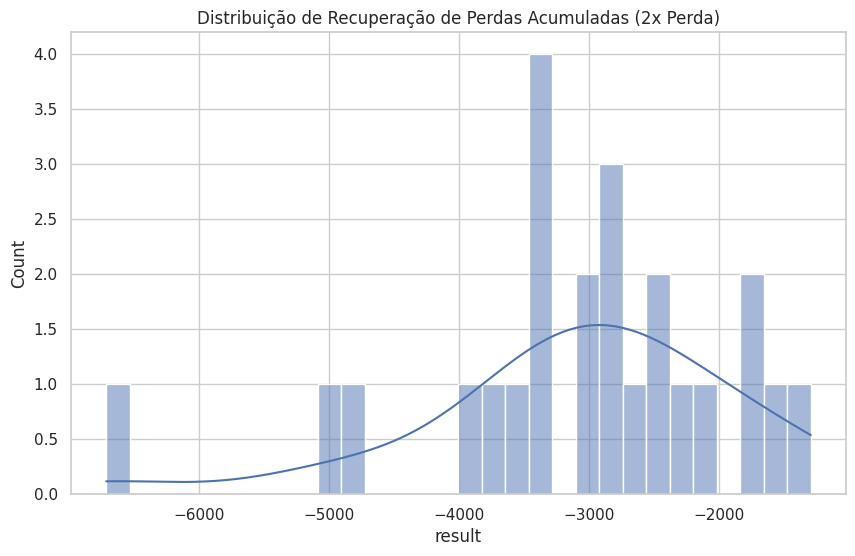


Eficiência do Cruzamento Reverso (Trigger Type 4)
Resultado médio de cruzamento reverso: -2934.3333333333317


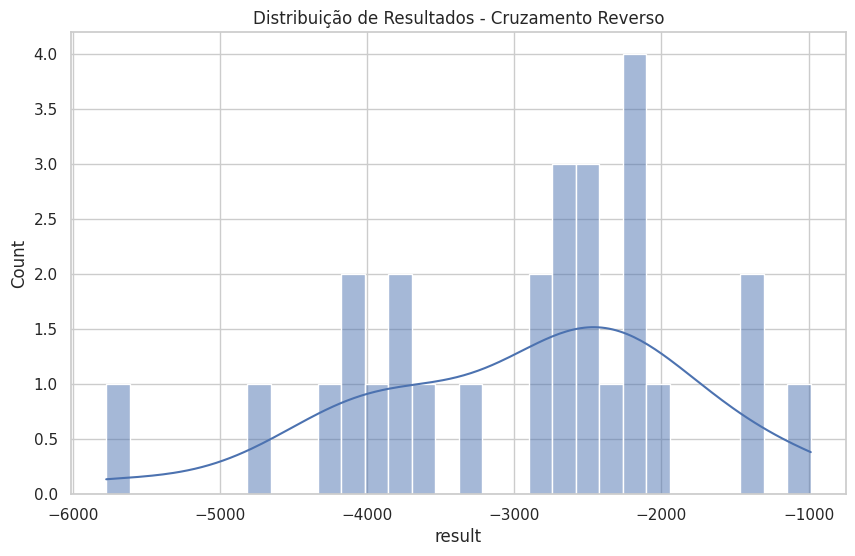


Análise de Take Profit (Trigger Type 1) e Stop Loss (Trigger Type 2)
Take Profit médio: 828.7500000000002
Stop Loss médio: 616.4022988505748


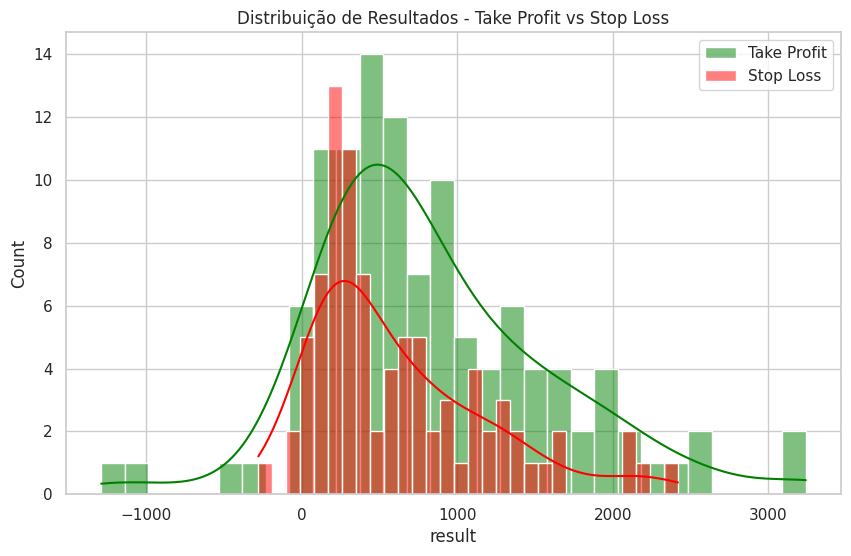


Análise de Drawdown e Recuperação


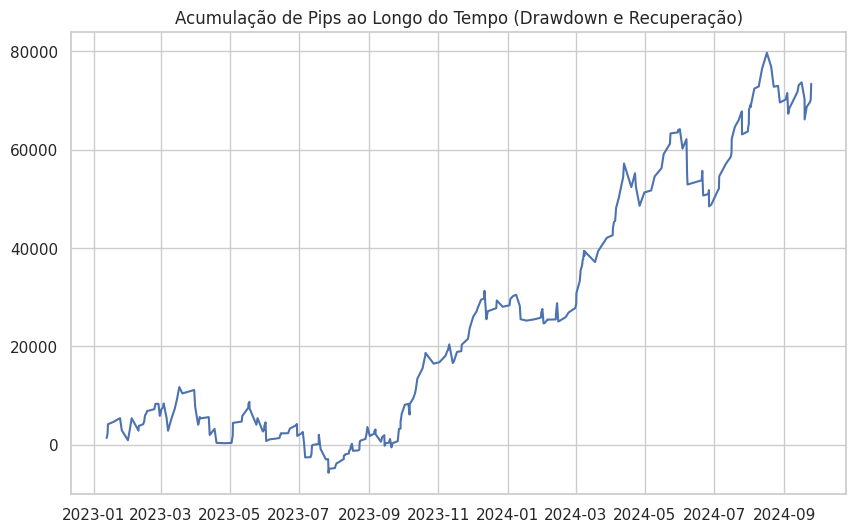


Análise de Eficiência Temporal e Tendências


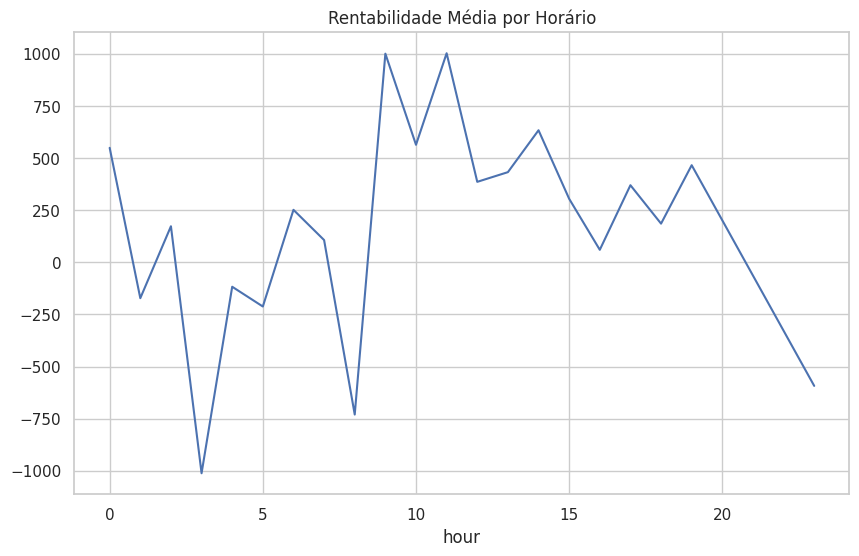

In [33]:
gerar_relatorios(df_results)

In [38]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Função para calcular drawdown
def calcular_drawdown(df):
    """Calcula o maior drawdown, considerando o menor valor subsequente ao pico."""
    max_pico = df['accumulated_pips'].cummax()
    drawdown = max_pico - df['accumulated_pips']
    return drawdown.max()

# Função para calcular sequências de ganhos e perdas consecutivas
def calcular_sequencia_ganhos_perdas(df):
    """Calcula a quantidade de ganhos e perdas consecutivas."""
    df['result_positive'] = df['result'] > 0
    df['sequencia'] = (df['result_positive'] != df['result_positive'].shift(1)).cumsum()
    sequencias = df.groupby(['sequencia', 'result_positive']).size().reset_index(name='count')
    
    ganhos_consecutivos = sequencias[sequencias['result_positive'] == True]['count'].max()
    perdas_consecutivas = sequencias[sequencias['result_positive'] == False]['count'].max()
    
    return ganhos_consecutivos, perdas_consecutivas

# Função principal para gerar o relatório completo
def gerar_relatorio_completo(df):
    sns.set(style="whitegrid")
    
    # Formatação textual para o notebook
    def format_section(title):
        print("#" * 60)
        print(f"# {title}")
        print("#" * 60, "\n")
    
    format_section("1. Análise de Desempenho por Tipo de Fechamento (Trigger Type)")
    
    trigger_counts = df['trigger_type'].value_counts(normalize=True) * 100
    trigger_means = df.groupby('trigger_type')['result'].mean()
    trigger_durations = df.groupby('trigger_type')['count'].mean()
    
    print(f"Distribuição de operações por tipo de fechamento (em %):\n{trigger_counts}\n")
    print(f"Média de pips ganhos/perdidos por tipo de fechamento:\n{trigger_means}\n")
    print(f"Tempo médio (em candles) das operações por tipo de fechamento:\n{trigger_durations}\n")
    
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x='trigger_type', palette='viridis')
    plt.title("Frequência de Operações por Tipo de Fechamento")
    plt.xlabel("Tipo de Fechamento")
    plt.ylabel("Número de Operações")
    plt.show()

    format_section("2. Análise de Rentabilidade por Compra e Venda (Signal)")
    
    signal_counts = df['SIGNAL'].value_counts(normalize=True) * 100
    signal_means = df.groupby('SIGNAL')['result'].mean()
    signal_durations = df.groupby('SIGNAL')['count'].mean()

    print(f"Distribuição de operações de compra e venda (em %):\n{signal_counts}\n")
    print(f"Média de pips ganhos/perdidos em operações de compra (1) e venda (-1):\n{signal_means}\n")
    print(f"Tempo médio (em candles) das operações de compra e venda:\n{signal_durations}\n")


    format_section("3. Rentabilidade por Compra e Venda com relação ao Tipo de Fechamento")
    
    for trigger in df['trigger_type'].unique():
        print(f"Trigger Type {trigger}:")
        group = df[df['trigger_type'] == trigger].groupby('SIGNAL')['result'].mean()
        print(f"  Compra (1): {group.get(1, 'N/A')}")
        print(f"  Venda (-1): {group.get(-1, 'N/A')}")
        print()

    format_section("4. Tempo médio de operação e impacto nos resultados")
    
    signal_trigger_durations = df.groupby(['SIGNAL', 'trigger_type'])['count'].mean()
    print(f"Tempo médio de operação por tipo de fechamento e compra/venda:\n{signal_trigger_durations}\n")

    format_section("5. Análise de Volatilidade e Duração das Operações (Count)")
    
    count_result_corr = df[['count', 'result']].corr().iloc[0, 1]
    print(f"Correlação entre a duração das operações (candles) e o resultado: {count_result_corr}\n")

    plt.figure(figsize=(10, 6))
    sns.scatterplot(data=df, x='count', y='result', hue='trigger_type', palette='coolwarm')
    plt.title("Duração das Operações (Candles) vs. Resultado (Pips)")
    plt.xlabel("Duração (Candles)")
    plt.ylabel("Resultado (Pips)")
    plt.show()

    format_section("6. Análise de Fechamento por Perdas Acumuladas (Trigger Type 3)")
    
    acum_loss_df = df[df['trigger_type'] == 3]
    if not acum_loss_df.empty:
        print(f"Frequência de operações com perdas acumuladas: {len(acum_loss_df)}")
        print(f"Lucro médio recuperado (2x perda): {acum_loss_df['result'].mean()}")
        print(f"Tempo médio de recuperação (em candles): {acum_loss_df['count'].mean()}\n")
    else:
        print("Nenhuma operação de perdas acumuladas encontrada.\n")
    
    format_section("7. Análise de Eficiência do Cruzamento Reverso (Trigger Type 4)")
    
    rev_cross_df = df[df['trigger_type'] == 4]
    if not rev_cross_df.empty:
        print(f"Frequência de operações com cruzamento reverso: {len(rev_cross_df)}")
        print(f"Lucro médio em cruzamentos reversos: {rev_cross_df['result'].mean()}")
        print(f"Tempo médio até cruzamento reverso (em candles): {rev_cross_df['count'].mean()}\n")
    else:
        print("Nenhuma operação de cruzamento reverso encontrada.\n")

    format_section("8. Análise de Drawdown e Recuperação")
    
    df['accumulated_pips'] = df['result'].cumsum()
    max_drawdown = calcular_drawdown(df)
    print(f"Maior drawdown subsequente: {max_drawdown} pips\n")
    
    format_section("9. Análise de Drawdown por Tipo de Fechamento")
    
    for trigger in df['trigger_type'].unique():
        print(f"Trigger Type {trigger}:")
        trigger_df = df[df['trigger_type'] == trigger]
        if not trigger_df.empty:
            drawdown = calcular_drawdown(trigger_df)
            print(f"  Maior drawdown subsequente: {drawdown} pips")
        else:
            print(f"  Nenhuma operação para Trigger Type {trigger}")
        print()

    format_section("10. KPIs Principais")
    
    total_operations = len(df)
    winning_operations = len(df[df['result'] > 0])
    losing_operations = len(df[df['result'] < 0])
    success_rate = (winning_operations / total_operations) * 100
    profit_factor = df[df['result'] > 0]['result'].sum() / abs(df[df['result'] < 0]['result'].sum())
    
    ganhos_consecutivos, perdas_consecutivas = calcular_sequencia_ganhos_perdas(df)

    print(f"Taxa de sucesso: {success_rate:.2f}%")
    print(f"Profit Factor: {profit_factor:.2f}")
    print(f"Maior sequência de ganhos consecutivos: {ganhos_consecutivos}")
    print(f"Maior sequência de perdas consecutivas: {perdas_consecutivas}\n")
    
    format_section("11. Quantidade de Operações com Lucro e Perda")
    
    # Operações com lucro e perda no geral
    total_lucro = len(df[df['result'] > 0])
    total_perda = len(df[df['result'] < 0])
    
    print(f"Total de Operações com Lucro: {total_lucro}")
    print(f"Total de Operações com Perda: {total_perda}\n")
    
    # Por tipo de operação (Compra e Venda)
    print("Por Compra e Venda:")
    for signal in df['SIGNAL'].unique():
        lucro = len(df[(df['SIGNAL'] == signal) & (df['result'] > 0)])
        perda = len(df[(df['SIGNAL'] == signal) & (df['result'] < 0)])
        operacao = "Compra (1)" if signal == 1 else "Venda (-1)"
        print(f"{operacao}:")
        print(f"  Operações com Lucro: {lucro}")
        print(f"  Operações com Perda: {perda}\n")
    
    # Por tipo de fechamento (Trigger Type)
    print("Por Tipo de Fechamento:")
    for trigger in df['trigger_type'].unique():
        lucro = len(df[(df['trigger_type'] == trigger) & (df['result'] > 0)])
        perda = len(df[(df['trigger_type'] == trigger) & (df['result'] < 0)])
        print(f"Trigger Type {trigger}:")
        print(f"  Operações com Lucro: {lucro}")
        print(f"  Operações com Perda: {perda}\n")

    format_section("12. Gráficos e Visualizações")
    
    # Distribuição de triggers
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x='trigger_type', palette='coolwarm')
    plt.title("Distribuição de Fechamentos por Tipo de Trigger")
    plt.show()
    
    # Saldo acumulado de pips ao longo do tempo
    plt.figure(figsize=(10, 6))
    df.plot(x='start_time', y='accumulated_pips', kind='line', title="Saldo Acumulado de Pips ao Longo do Tempo")
    plt.show()

# Exemplo de uso:
# df = pd.read_csv('seu_arquivo.csv')  # Ajustar o caminho do arquivo conforme necessário
# gerar_relatorio_completo(df)


############################################################
# 1. Análise de Desempenho por Tipo de Fechamento (Trigger Type)
############################################################ 

Distribuição de operações por tipo de fechamento (em %):
trigger_type
1    38.487973
2    29.896907
5     9.621993
4     9.278351
3     8.247423
6     4.467354
Name: proportion, dtype: float64

Média de pips ganhos/perdidos por tipo de fechamento:
trigger_type
1     828.750000
2     616.402299
3   -3096.458333
4   -2934.333333
5    2152.571429
6    1556.615385
Name: result, dtype: float64

Tempo médio (em candles) das operações por tipo de fechamento:
trigger_type
1    1707.991071
2    1662.942529
3    2267.041667
4    3168.777778
5     643.428571
6     759.692308
Name: count, dtype: float64



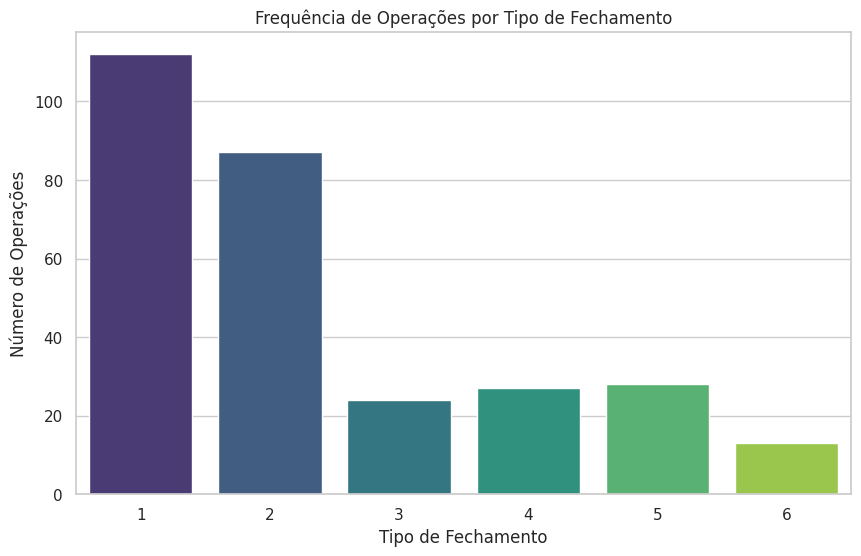

############################################################
# 2. Análise de Rentabilidade por Compra e Venda (Signal)
############################################################ 

Distribuição de operações de compra e venda (em %):
SIGNAL
0    100.0
Name: proportion, dtype: float64

Média de pips ganhos/perdidos em operações de compra (1) e venda (-1):
SIGNAL
0    252.278351
Name: result, dtype: float64

Tempo médio (em candles) das operações de compra e venda:
SIGNAL
0    1731.371134
Name: count, dtype: float64

############################################################
# 3. Rentabilidade por Compra e Venda com relação ao Tipo de Fechamento
############################################################ 

Trigger Type 1:
  Compra (1): N/A
  Venda (-1): N/A

Trigger Type 3:
  Compra (1): N/A
  Venda (-1): N/A

Trigger Type 4:
  Compra (1): N/A
  Venda (-1): N/A

Trigger Type 5:
  Compra (1): N/A
  Venda (-1): N/A

Trigger Type 6:
  Compra (1): N/A
  Venda (-1): N/A

Trigger Type 2:
  

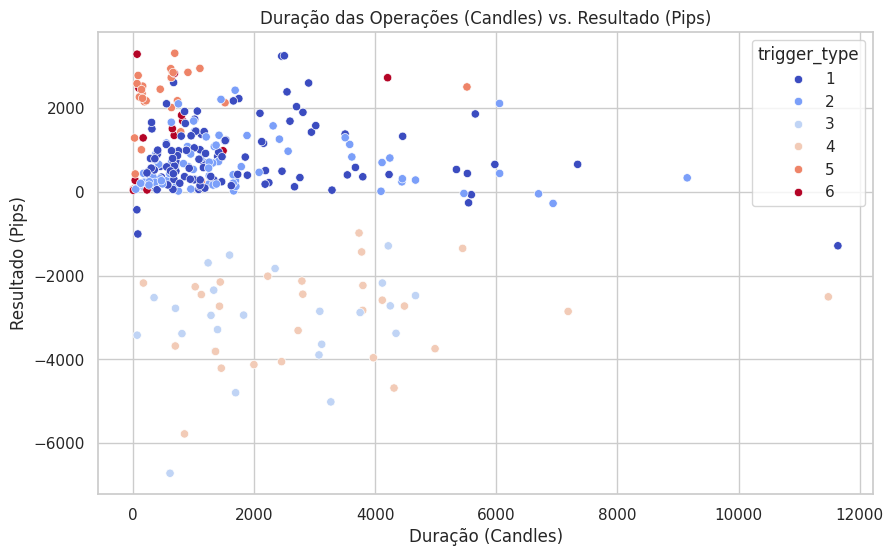

############################################################
# 6. Análise de Fechamento por Perdas Acumuladas (Trigger Type 3)
############################################################ 

Frequência de operações com perdas acumuladas: 24
Lucro médio recuperado (2x perda): -3096.458333333337
Tempo médio de recuperação (em candles): 2267.0416666666665

############################################################
# 7. Análise de Eficiência do Cruzamento Reverso (Trigger Type 4)
############################################################ 

Frequência de operações com cruzamento reverso: 27
Lucro médio em cruzamentos reversos: -2934.3333333333317
Tempo médio até cruzamento reverso (em candles): 3168.777777777778

############################################################
# 8. Análise de Drawdown e Recuperação
############################################################ 

Maior drawdown subsequente: 17440.999999999964 pips

############################################################
# 

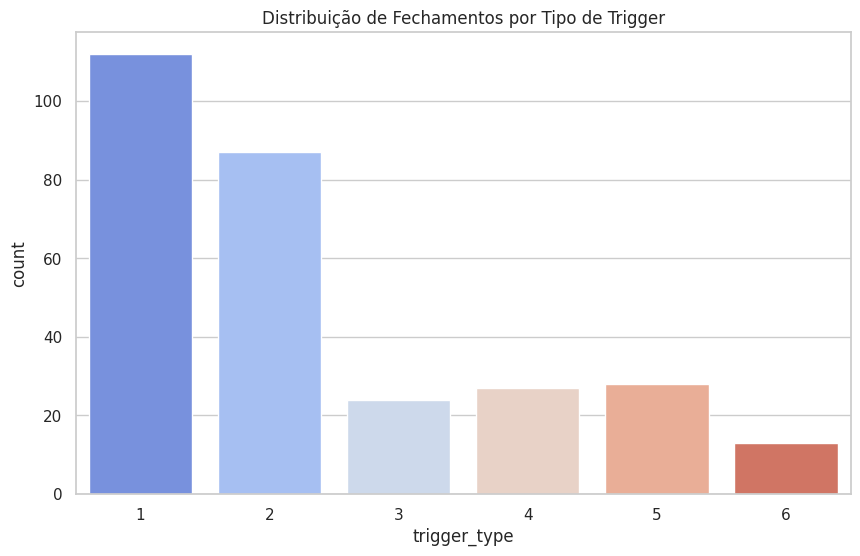

<Figure size 1000x600 with 0 Axes>

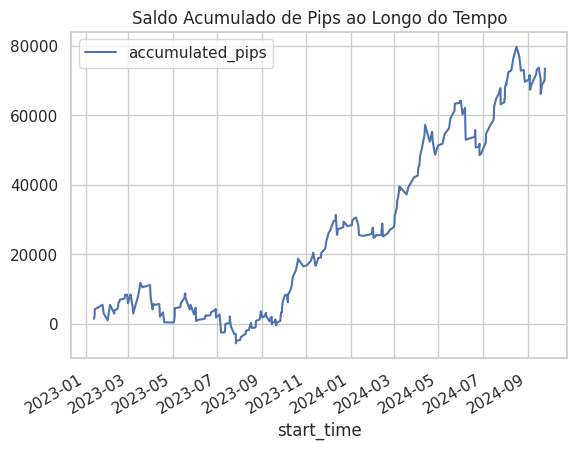

In [39]:
gerar_relatorio_completo(df_results)